# Document categorization; Supervised learning on text data

---  

# Objective of this notebook
Classify the word documents to one of the following categories:

1. Confidential
2. Non-Confidential
3. Restricted
4. Secret
5. Unclassified
 


<h4>Read and preprocess the metadata of the documents</h4>

In [1]:
import pandas as pd 
import json
from Preprocessing_Functions import read_metadata, preprocess
import string
import re
import spacy
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer

In [2]:
from nltk.stem import WordNetLemmatizer 
lemmatizer = WordNetLemmatizer() 

def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
    """https://spacy.io/api/annotation"""
    texts_out = []
    texts_temp = []
    for sent in texts:                
        sent1 = ''
        sent_list = sent.split(' ')
        for word in sent_list:
            sent1 = sent1 + ' ' + lemmatizer.lemmatize(word)            
        
        texts_temp.append(sent1)
    doc = nlp(" ".join(texts_temp))    
    texts_out = [token.text for token in doc if token.pos_ in allowed_postags] 
    #final_lst= [item for text_out in texts_out for item in text_out]
    final = [" ".join(texts_out)]
    return texts_temp

texts= read_metadata()

lst = []
for w in texts:
    title = w[0]
    title = title.replace('www.','')
    title = title.replace('au','')
    title = title.replace('com','')
    title = title.replace('gov','')
    title = title[0:25]
    title = ' '.join(title.split('.')) 
    lst.append(title + ' ' + w[1])
    
#textlist = [w for w in lst] 
textlist = [w[1] for w in texts]
#Since we are using all the content of the file for this classficication, we need to pre-process it.
#doc_text  = [preprocess(d) for d in textlist]
docwordlist =[]
for text in textlist:
    lst =[]
    translator = str.maketrans('', '', string.punctuation)
    text = text.translate(translator)
    
    #remove numbers
    text = re.sub(r'\d+', '', text)
    
    
    lst.append(text)    
    nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner'])
    lst1= lemmatization(lst) 
    
    stop_words = stopwords.words('english')
    stop_words.extend(['tag','text','text_contents','contents','textcontents']) 
    vec = CountVectorizer(ngram_range=(1, 2), stop_words=stop_words).fit(lst1)
    bag_of_words = vec.transform(lst1)

    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    #print(bigram_mod[doc_text[2]])

    wordlist = []
    for word, freq in words_freq: 
        wordlist.append(word)

    docwordlist.append(wordlist) 

print('PRE-PROCESSED(TOKENIZED) DATA')



PRE-PROCESSED(TOKENIZED) DATA


<h4>Create a dataframe and update it with cleaned and pre-processed tokens</h4>

In [3]:
df = pd.read_json('./Output/scan.json',orient='index')
#df = df.applymap(str)
#print(len(doc_text))
print(df.shape)
print(len(docwordlist))


for i, row in df.iterrows():   
    df.at[i,'content'] = ','.join(docwordlist[i-1])
    

(493, 9)
493


In [4]:
print(docwordlist[0])
df.head()

['stand', 'support', 'business', 'government', 'hour', 'role', 'wage', 'time', 'step', 'namepartial', 'many', 'unpaid', 'previous', 'workinsert', 'social', 'distancing', 'requirement', 'useful', 'unforeseen', 'challenge', 'home', 'agreement', 'work', 'phone', 'detail', 'function', 'jobkeeper', 'working', 'wage support', 'support time', 'time step', 'step namepartial', 'namepartial stand', 'stand stand', 'stand many', 'many business', 'business unpaid', 'unpaid stand', 'stand business', 'business government', 'government support', 'support previous', 'previous hour', 'hour workinsert', 'workinsert hour', 'hour social', 'social distancing', 'distancing requirement', 'requirement useful', 'useful role', 'role unforeseen', 'unforeseen challenge', 'challenge home', 'home agreement', 'agreement role', 'role work', 'work phone', 'phone detail', 'detail function', 'function government', 'government jobkeeper', 'jobkeeper working']


,content,title,authors,last_modified_by,created_date,modified_date,location,category,summary
1,"stand,support,business,government,hour,role,wa...",ciavic.com.au_getmedia_0743c48c-dede-4147-9157...,Ian Jordan,Dan Feldman,2020-03-30 23:52:00,2020-03-30 23:53:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,{'text_contents': {'tags': ['other wage suppor...
2,"home,company,wfh,office,home office,arrangemen...",ciavic.com.au_getmedia_0fa35ff6-457d-4a91-bedf...,None,None,2020-03-29 21:34:00,2020-03-29 22:30:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,{'text_contents': {'tags': ['wfh arrangementyo...
3,"employee,document,employment,business,support,...",ciavic.com.au_getmedia_a0ad087d-48ca-40f9-8717...,CIAUSER,CIAUSER,2020-04-06 21:38:00,2020-04-06 23:10:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,"{'text_contents': {'tags': ['employees', 'affe..."
4,"support,business,government,wage,many,step,soc...",ciavic.com.au_getmedia_a20d2e1a-9c33-41c4-b757...,Ian Jordan,Dan Feldman,2020-03-30 23:50:00,2020-03-30 23:51:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,{'text_contents': {'tags': ['other wage suppor...
5,"redundancy,business,service,week,leave,notice,...",ciavic.com.au_getmedia_a851a766-8227-4464-ab27...,Dan Feldman,Dan Feldman,2020-03-29 21:21:00,2020-03-29 21:21:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,"{'text_contents': {'tags': ['redundancy pay', ..."


<h4>Get documents in each category</h4>

In [5]:
df['category_id'] = df['category'].factorize()[0]
df["category"].value_counts()
df.tail()
category_id_df = df[['category', 'category_id']].drop_duplicates()


# Dictionaries for future use
category_to_id = dict(category_id_df.values)
id_to_category = dict(category_id_df[['category_id', 'category']].values)

print(category_to_id)
print(id_to_category)

{'confidential': 0, 'non-confidential': 1, 'restricted': 2, 'secret': 3, 'Unclassified': 4}
{0: 'confidential', 1: 'non-confidential', 2: 'restricted', 3: 'secret', 4: 'Unclassified'}


<h4>Document Category distribution </h4>

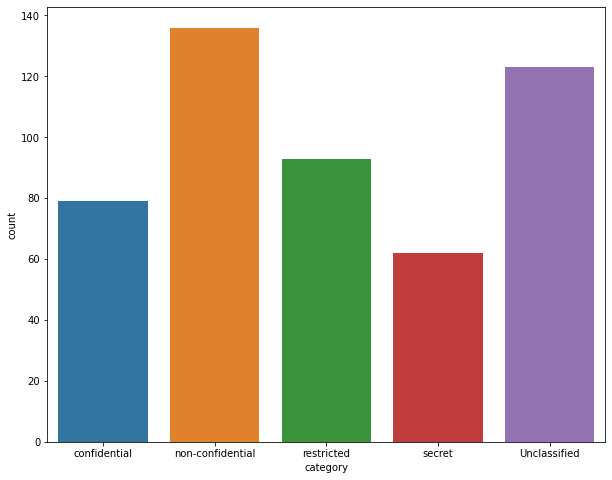

In [6]:
from matplotlib import rcParams
import seaborn as sns

rcParams["figure.figsize"] = 10,8
a=sns.countplot(x = df["category"])

<h4>Add a new column to show length of each document</h4>

In [7]:
df['document_len'] = df['content'].astype(str).apply(len)

df.head()

,content,title,authors,last_modified_by,created_date,modified_date,location,category,summary,category_id,document_len
1,"stand,support,business,government,hour,role,wa...",ciavic.com.au_getmedia_0743c48c-dede-4147-9157...,Ian Jordan,Dan Feldman,2020-03-30 23:52:00,2020-03-30 23:53:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,{'text_contents': {'tags': ['other wage suppor...,0,749
2,"home,company,wfh,office,home office,arrangemen...",ciavic.com.au_getmedia_0fa35ff6-457d-4a91-bedf...,None,None,2020-03-29 21:34:00,2020-03-29 22:30:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,{'text_contents': {'tags': ['wfh arrangementyo...,0,942
3,"employee,document,employment,business,support,...",ciavic.com.au_getmedia_a0ad087d-48ca-40f9-8717...,CIAUSER,CIAUSER,2020-04-06 21:38:00,2020-04-06 23:10:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,"{'text_contents': {'tags': ['employees', 'affe...",0,811
4,"support,business,government,wage,many,step,soc...",ciavic.com.au_getmedia_a20d2e1a-9c33-41c4-b757...,Ian Jordan,Dan Feldman,2020-03-30 23:50:00,2020-03-30 23:51:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,{'text_contents': {'tags': ['other wage suppor...,0,818
5,"redundancy,business,service,week,leave,notice,...",ciavic.com.au_getmedia_a851a766-8227-4464-ab27...,Dan Feldman,Dan Feldman,2020-03-29 21:21:00,2020-03-29 21:21:00,D:\Classification\StructureMe\StructureMe-mast...,confidential,"{'text_contents': {'tags': ['redundancy pay', ...",0,826


In [8]:
import matplotlib.pyplot as plt
    
def tags_freq(tags, top=30, figsize=(10,5)):  
    
    my_list =  [item.split(",") for item in tags]  
    
    tags_list = tags.sum()
    map_lst= [item for sublist in my_list for item in sublist]
    dtf_tags = pd.DataFrame(map_lst,columns=['tag'])
    
    dtf_tags["count"] = 1
    dtf_tags = dtf_tags.groupby(['tag']).count().reset_index().sort_values("count", ascending=False)
    fig, ax = plt.subplots(figsize=figsize)
    fig.suptitle("Top frequent words", fontsize=12)
    sns.barplot(x="count", y="tag", data=dtf_tags.iloc[:top,:], dodge=False, ax=ax)
    ax.set(ylabel=None)
    ax.grid(axis="x")
    plt.show()
    return dtf_tags

# confidential:


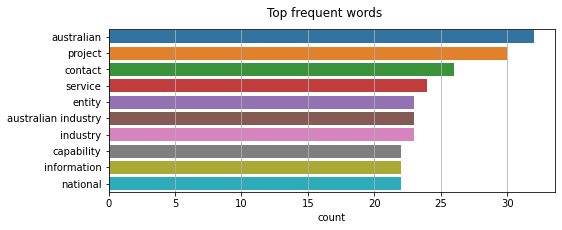

# non-confidential:


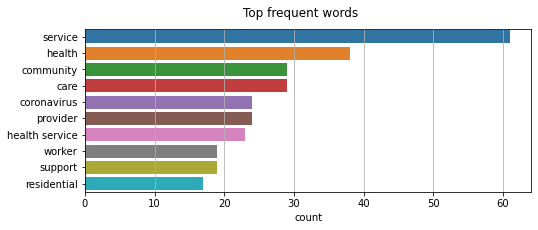

# restricted:


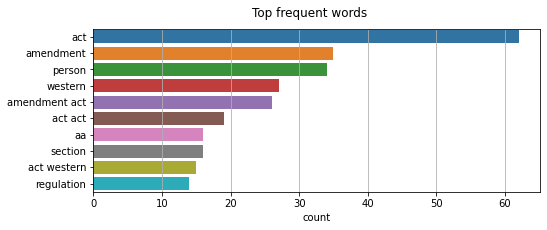

# secret:


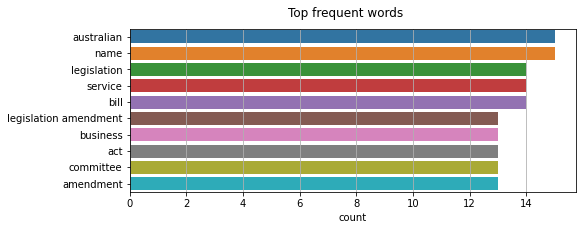

# Unclassified:


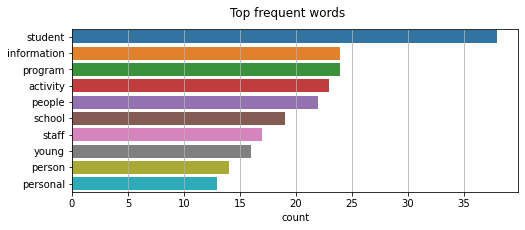

In [9]:
for y in df["category"].unique():
    print("# {}:".format(y))
    common_tags = tags_freq(tags=df[df["category"]==y]["content"], top=10, figsize=(8,3))

<h4>Document length distribution</h4>

In [10]:
#from plotly import __version__
%matplotlib inline
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)


df['document_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='document length',
    linecolor='black',
    yTitle='no of documents',
    title='Document Text Length Distribution')

### Let us split the dataframe to test and train

In [11]:
from sklearn.model_selection import train_test_split

df_train, df_test = train_test_split(df, test_size=0.2,shuffle=True ,random_state=42)
#df_train, df_test = train_test_split(df, test_size=0.2,random_state=20)
## get target
y_train = df_train["category"].values
y_test = df_test["category"].values


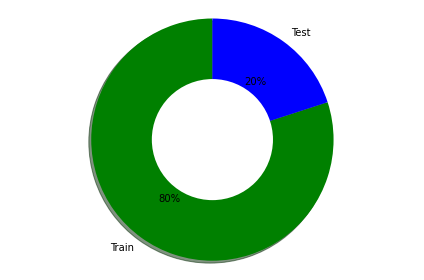

In [12]:
import matplotlib.pyplot as plt
name = ['Train', 'Test']
people = [80, 20]
plt.pie(people, labels=name, autopct='%0.f%%', colors=['green','blue'] , shadow=True, startangle=90)

circle = plt.Circle((0,0),0.50,fc='white') 
donut = plt.gcf()
donut.gca().add_artist(circle)
plt.axis('equal')
plt.tight_layout()


<h4>Dehine TFIDF Vectorizer</h4>

In [13]:
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier,AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier

#transformer = TfidfTransformer(smooth_idf=False)
#count_vectorizer = CountVectorizer(ngram_range=(1, 2))
vectorizer = TfidfVectorizer(max_features=None, ngram_range=(1,2)) 
    


### Check how well the features are distributed and if our matrix is sparse


In [14]:
# This is the corpus , features used by model
corpus= df_train["content"]

# fit train data to the count vectorizer
vectorizer = vectorizer.fit(corpus)#.toarray()

#fit the ngrams count to the tfidf transformers
X_train = vectorizer.transform(corpus)
X_test = df_test["content"].values

print('Number of Documents to train : ' + str(len(corpus)))
print('Shape of feature matrix: ' + str(X_train.shape))

print(len(vectorizer.get_feature_names()))
dic_vocabulary = vectorizer.vocabulary_
print(len(dic_vocabulary), "words in dictionary vocabulary")


print('Number of Documents in Test: ' + str(len(X_test)))

Number of Documents to train : 394
Shape of feature matrix: (394, 28831)
28831
28831 words in dictionary vocabulary
Number of Documents in Test: 99


## Train the models

In [15]:
from sklearn import pipeline

def fit_ml_classif(X_train, y_train, X_test, vectorizer=None, classifier=None): 
    ## model pipeline
    vectorizer = TfidfVectorizer() if vectorizer is None else vectorizer
    classifier = naive_bayes.MultinomialNB() if classifier is None else classifier
    model = pipeline.Pipeline([("vectorizer",vectorizer), ("classifier",classifier)])
    
    ## train
    if vectorizer is None:
        model.fit(X_train, y_train)
    else:
        model["classifier"].fit(X_train, y_train)
    
    ## test
    predicted = model.predict(X_test)
    predicted_prob = model.predict_proba(X_test)
    return model, predicted_prob, predicted

### Call Naive Bayes model

In [16]:
from sklearn.naive_bayes import MultinomialNB
from sklearn import metrics
# Predict and calculate accuracy
from sklearn.metrics import accuracy_score

classifier = MultinomialNB()

model, predicted_prob, predicted = fit_ml_classif(X_train,y_train,X_test, vectorizer, classifier)


print('Accuracy of Naive Bayes classifier on training set: {:.2f}'.format(classifier.score(X_train, y_train)))
accuracy = metrics.accuracy_score(y_test, predicted)
print("Accuracy of Naive Bayes classifier on test set: {:.2f}".format(round(accuracy,2)))


Accuracy of Naive Bayes classifier on training set: 0.97
Accuracy of Naive Bayes classifier on test set: 0.84


## Call Logistic Regression

In [17]:
from sklearn.linear_model import LogisticRegression
#logreg_classifier = LogisticRegression()#(C=1e5,max_iter=3000)
#logreg_classifier = LogisticRegression(penalty='l2', C=10 , solver='liblinear')
logreg_classifier = LogisticRegression()
logreg_model, logreg_predicted_prob, logreg_predicted = fit_ml_classif(X_train,y_train,X_test, vectorizer, logreg_classifier)


print('Accuracy of Logreg classifier on training set: {:.2f}'.format(logreg_classifier.score(X_train, y_train)))
accuracy = metrics.accuracy_score(y_test, logreg_predicted)
print('Accuracy of Logreg classifier on testing set: {:.2f}'.format(round(accuracy,2)))

Accuracy of Logreg classifier on training set: 0.98
Accuracy of Logreg classifier on testing set: 0.86


#### Using one over rest approach (binary classification)

In [18]:
logreg_biclassifier = LogisticRegression(multi_class='ovr')

logreg_bimodel, logreg_bipredicted_prob, logreg_bipredicted = fit_ml_classif(X_train,y_train,X_test, vectorizer, logreg_biclassifier)
X_test_x= vectorizer.transform(X_test)
yhat = logreg_biclassifier.predict(X_test_x)
#print(yhat)

print('Accuracy of Logreg classifier on training set: {:.2f}'.format(logreg_biclassifier.score(X_train, y_train)))
bi_accuracy = metrics.accuracy_score(y_test, logreg_bipredicted)
print('Accuracy of Logreg classifier on testing set: {:.2f}'.format(round(bi_accuracy,2)))

Accuracy of Logreg classifier on training set: 0.98
Accuracy of Logreg classifier on testing set: 0.84


### Apply regularization

In [20]:
from sklearn.model_selection import GridSearchCV
 # Set values of the grid search
C_values = [0.001, 0.01, 0.1, 1, 10, 100]
C_grid = {'C': C_values}
# Set the amount of folds for the cross-validation
n_folds = 5
# Do a model fit over a grid of C hyperparameters
logReg = LogisticRegression(multi_class='ovr')
grid_logReg = GridSearchCV(logReg, C_grid, cv=n_folds, refit=True)
grid_logReg.fit(X_train, y_train)

GridSearchCV(cv=5, error_score=nan,
             estimator=LogisticRegression(C=1.0, class_weight=None, dual=False,
                                          fit_intercept=True,
                                          intercept_scaling=1, l1_ratio=None,
                                          max_iter=100, multi_class='ovr',
                                          n_jobs=None, penalty='l2',
                                          random_state=None, solver='lbfgs',
                                          tol=0.0001, verbose=0,
                                          warm_start=False),
             iid='deprecated', n_jobs=None,
             param_grid={'C': [0.001, 0.01, 0.1, 1, 10, 100]},
             pre_dispatch='2*n_jobs', refit=True, return_train_score=False,
             scoring=None, verbose=0)

#### Check best C value for the model

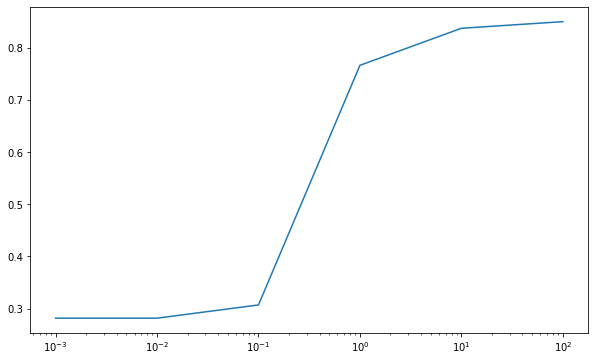

In [21]:
plt.figure().set_size_inches(10, 6)
fg2 = plt.semilogx(C_values, grid_logReg.cv_results_['mean_test_score'])
plt.savefig('figure_2.png')

#### Train model with best C value

In [22]:
X_test_x= vectorizer.transform(X_test)
full_col_names = list(df_train['content'])

best_logReg = grid_logReg.best_estimator_

#for row in logreg_classifier.coef_:
#   print(row)
X_test_x= vectorizer.transform(X_test)

print('Accuracy of Logreg classifier on training set: {:.2f}'.format(best_logReg.score(X_train, y_train)))
print('Accuracy of Logreg classifier on testing  set: {:.2f}'.format(best_logReg.score(X_test_x,y_test)))


Accuracy of Logreg classifier on training set: 1.00
Accuracy of Logreg classifier on testing  set: 0.90


#### Top features and their coefficients used by Logistic regression

Unclassified


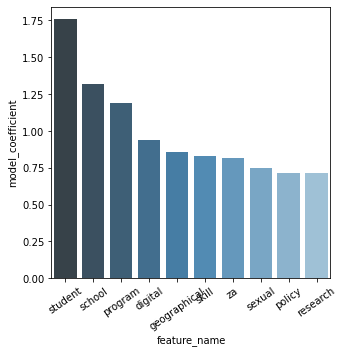

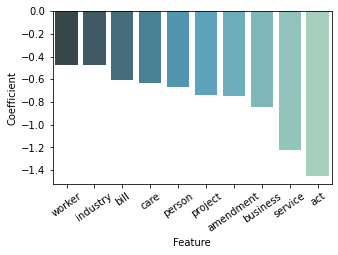

confidential


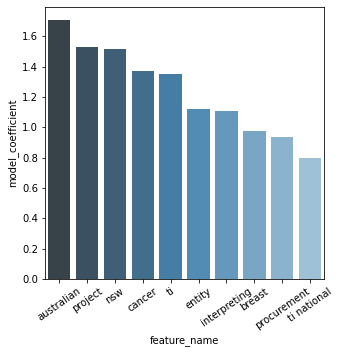

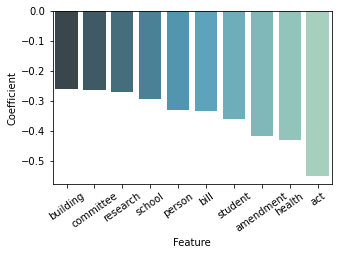

non-confidential


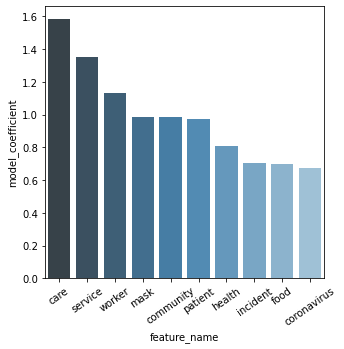

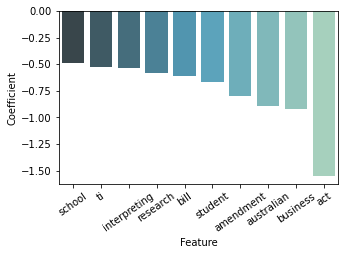

restricted


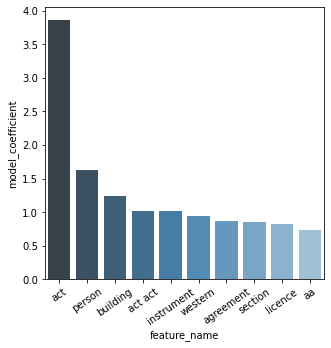

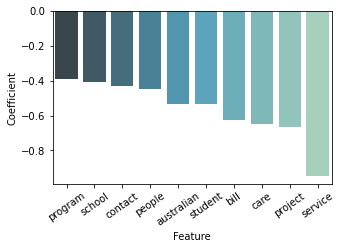

secret


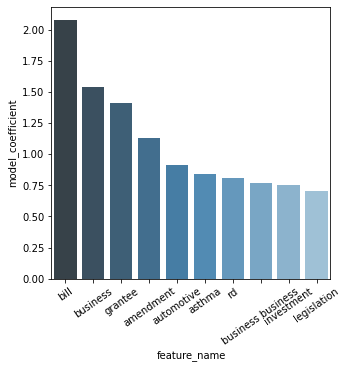

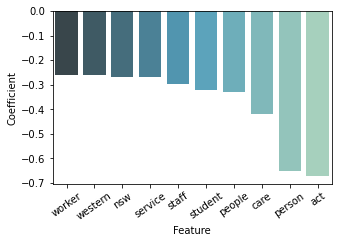

In [23]:
#print(logreg_classifier.classes_)
i=0
for coef_class in logreg_biclassifier.classes_:
    print(coef_class)
    logReg_coeff = pd.DataFrame({'feature_name': vectorizer.get_feature_names(), 'model_coefficient': logreg_biclassifier.coef_[i].transpose().flatten()})
    logReg_coeff = logReg_coeff.sort_values('model_coefficient',ascending=False)
    logReg_coeff_top = logReg_coeff.head(10)
    logReg_coeff_bottom = logReg_coeff.tail(10)
    # Plot top 5 coefficients
    plt.figure().set_size_inches(5, 5)
    fg3 = sns.barplot(x='feature_name', y='model_coefficient',data=logReg_coeff_top, palette="Blues_d")
    fg3.set_xticklabels(rotation=35, labels=logReg_coeff_top.feature_name)
    # Plot bottom 5 coefficients
    plt.figure().set_size_inches(5,5)
    fg4 = sns.barplot(x='feature_name', y='model_coefficient',data=logReg_coeff_bottom, palette="GnBu_d")
    fg4.set_xticklabels(rotation=35, labels=logReg_coeff_bottom.feature_name)
    plt.xlabel('Feature')
    plt.ylabel('Coefficient')
    plt.subplots_adjust(bottom=0.4)
    plt.savefig('figure_4.png')
    plt.show()
    i= i+1
   

### Call XGBoost 

In [24]:
from xgboost import XGBClassifier
import xgboost as xgb
from sklearn.metrics import precision_score

XG = XGBClassifier( use_label_encoder=False, objective='multi:softprob',num_class = 5, eta= 0.3 , max_depth = 3)

y_train_xg = df_train["category_id"].values
y_test_xg = df_test['category_id'].values
xg_model, xg_predicted_prob, xg_predicted = fit_ml_classif(X_train,y_train_xg, X_test, vectorizer, XG)


print('Accuracy of xgboost classifier on training set: {:.2f}'.format(XG.score(X_train, y_train_xg)))
X_test_x= vectorizer.transform(X_test)
print('Accuracy of xgboost classifier on test set: {:.2f}'.format(XG.score(X_test_x, y_test_xg)))

[09:47:42] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy of xgboost classifier on training set: 1.00
Accuracy of xgboost classifier on test set: 0.78


#### Fine tune XG Boost parameters

In [26]:
import numpy as np

X_test_xg= vectorizer.transform(X_test)
dtrain = xgb.DMatrix(X_train, label=y_train_xg)
dtest = xgb.DMatrix(X_test_xg, label=y_test_xg)
param = {
    'max_depth': 3,  # the maximum depth of each tree
    'eta': 0.3,  # the training step for each iteration    
    'objective': 'multi:softprob',  # error evaluation for multiclass training
    'num_class': 5}  # the number of classes that exist in this datset
num_round = 10  # the number of training iterations
bst = xgb.train(param, dtrain, num_round)

preds = bst.predict(dtest)
train_preds = bst.predict(dtrain)
train_best_preds = np.asarray([np.argmax(line) for line in train_preds])
best_preds = np.asarray([np.argmax(line) for line in preds])

xg_train_score =  precision_score(y_train_xg, train_best_preds , average='macro')
xg_score= precision_score(y_test_xg, best_preds, average='macro')



print( 'Accuracy of xgboost classifier on training set: {:.2f}'.format(xg_train_score))
print( 'Accuracy of xgboost classifier on test set: {:.2f}'.format(xg_score))

[09:48:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy of xgboost classifier on training set: 0.94
Accuracy of xgboost classifier on test set: 0.81


## Plot the probabilities of prediction from model

In [27]:
df_outProb = pd.DataFrame(logreg_predicted_prob,columns= ['Unclassified_prob','confidential_prob','non-confidential_prob','restricted_prob','secret_prob'])
df_outProb['prediction'] = logreg_predicted

df_outProb.head()

,Unclassified_prob,confidential_prob,non-confidential_prob,restricted_prob,secret_prob,prediction
0,0.377478,0.095564,0.256630,0.161743,0.108585,Unclassified
1,0.138517,0.472117,0.180385,0.107675,0.101306,confidential
2,0.106728,0.095499,0.095758,0.173616,0.528399,secret
3,0.142035,0.075259,0.489307,0.193980,0.099419,non-confidential
4,0.194850,0.092306,0.172097,0.142700,0.398047,secret


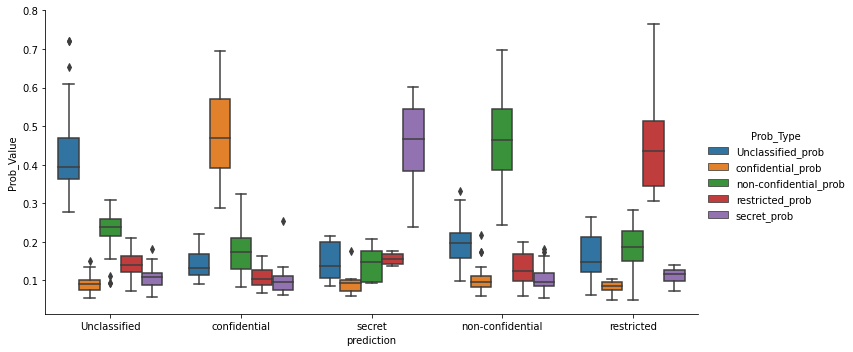

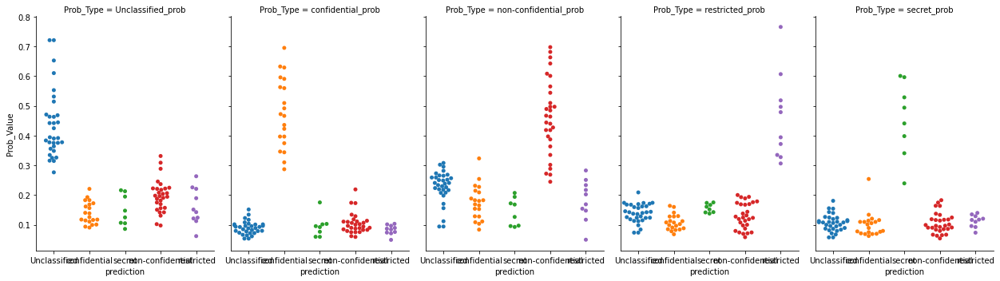

In [28]:
df_strip = pd.melt(df_outProb, id_vars= ['prediction'] , value_vars =['Unclassified_prob', 'confidential_prob','non-confidential_prob','restricted_prob','secret_prob'] , var_name ='Prob_Type', value_name ='Prob_Value')

a = sns.catplot(y="Prob_Value", x="prediction", hue="Prob_Type", kind="box", data=df_strip, height=5, aspect=2)

b=sns.catplot(x="prediction", y="Prob_Value", col="Prob_Type", aspect=.7, kind="swarm", data=df_strip)

### List the probabilities with incorrect prediction

In [29]:
df_outProb['Max Prob'] = df_outProb[["Unclassified_prob", "confidential_prob" ,'non-confidential_prob','restricted_prob','secret_prob']].max(axis=1)
df_outProb['Actual'] = y_test
df_outProb.head()

df_wrong = df_outProb.loc[df_outProb['Actual'] != df_outProb['prediction']]
df_wrong

,Unclassified_prob,confidential_prob,non-confidential_prob,restricted_prob,secret_prob,prediction,Max Prob,Actual
5,0.276342,0.134208,0.240729,0.208916,0.139805,Unclassified,0.276342,non-confidential
18,0.325015,0.116900,0.307866,0.125785,0.124435,Unclassified,0.325015,non-confidential
21,0.222417,0.111250,0.363381,0.169624,0.133328,non-confidential,0.363381,restricted
22,0.308774,0.084804,0.418308,0.097911,0.090203,non-confidential,0.418308,Unclassified
33,0.220820,0.172921,0.244747,0.178668,0.182843,non-confidential,0.244747,confidential
44,0.174971,0.218960,0.268586,0.173871,0.163612,non-confidential,0.268586,confidential
48,0.315658,0.101494,0.258919,0.169597,0.154333,Unclassified,0.315658,non-confidential
64,0.236836,0.110757,0.301624,0.175993,0.174790,non-confidential,0.301624,Unclassified
68,0.245451,0.118438,0.271979,0.200111,0.164021,non-confidential,0.271979,restricted
78,0.375366,0.079692,0.251535,0.174022,0.119385,Unclassified,0.375366,non-confidential


## Explain the decision of a test

In [30]:
from lime import lime_text
lstProb = list(df_wrong.index.values)
lstFeatures = []

## select observation
for i in  lstProb: #range(2,3):
    
    txt_instance = X_test[i]
    ## check true value and predicted value
    print("True:", y_test[i], "--> Pred:", logreg_predicted[i])
    ## show explanation

    explainer = lime_text.LimeTextExplainer(class_names = np.unique(y_test))
    explained = explainer.explain_instance(txt_instance, 
                 logreg_model.predict_proba, num_features=5, top_labels=2)
    #print(explained.available_labels())
    explained.show_in_notebook(text=txt_instance, predict_proba=True)
    label = explained.available_labels()[0]
    exp_map = explained.as_list(label=label)
    exp_map.append(logreg_predicted[i])
    print(exp_map)   
    lstFeatures.append(exp_map)
    

#print(logreg_predicted_prob)    

True: non-confidential --> Pred: Unclassified


[('act', -0.03904006796008087), ('business', -0.027920569610383677), ('people', 0.02563925826527257), ('complaint', 0.02541282022907967), ('first', 0.023896026697438243), 'Unclassified']
True: non-confidential --> Pred: Unclassified


[('case', 0.03093881220798262), ('workplace', 0.02441587797099649), ('contact', -0.01836885525835438), ('close', 0.015586949573171218), ('assessment', -0.012029522946126713), 'Unclassified']
True: restricted --> Pred: non-confidential


[('financial', 0.0969312625686357), ('land', -0.011677143526679847), ('annual', 0.0061120743358928755), ('year', -0.006021113115295034), ('government', -0.005831468731311187), 'non-confidential']
True: Unclassified --> Pred: non-confidential


[('incident', 0.0749516074882458), ('service', 0.0443902604373143), ('program', -0.027720125049405332), ('community', 0.02411348345842902), ('plan', -0.02076328588637877), 'non-confidential']
True: confidential --> Pred: non-confidential


[('business', -0.04968072813418549), ('support', 0.023887151403920198), ('employee', 0.022480589529672922), ('program', -0.015288426680740881), ('document', -0.012749445851449), 'non-confidential']
True: confidential --> Pred: non-confidential


[('business', -0.05842374444424281), ('support', 0.026472775233957305), ('government', -0.015547336170192229), ('many', 0.013846470594524972), ('unpaid', 0.011064447108828746), 'non-confidential']
True: non-confidential --> Pred: Unclassified


[('meeting', 0.04867176303766604), ('committee', 0.014402412380420447), ('street', -0.014096230448324223), ('association', -0.013410138875917136), ('form', -0.006445122935113358), 'Unclassified']
True: Unclassified --> Pred: non-confidential


[('stage', -0.017086086750535454), ('extension', 0.016055552311751594), ('assessment', 0.006405929530047998), ('yet', -0.000155337087788684), ('datestage', 0.0001052504693648149), 'non-confidential']
True: restricted --> Pred: non-confidential


[('partnership', -0.008242351213888412), ('partner', -0.006949645418185859), ('existing', -0.004715279041874561), ('recognised', 0.004442602284021902), ('limited', 0.0016444453889865047), 'non-confidential']
True: non-confidential --> Pred: Unclassified


[('policy', 0.11859952856364513), ('person', -0.03352002031922047), ('name', -0.02075943437736974), ('staff', 0.019255785131825295), ('requirement', -0.014787849078284785), 'Unclassified']
True: restricted --> Pred: non-confidential


[('service', 0.11214197648697144), ('international', 0.014514468967848507), ('head', -0.012391270014015032), ('tour', -0.011697821406749225), ('youth', -0.008823530716761199), 'non-confidential']
True: secret --> Pred: Unclassified


[('school', 0.1257476640721729), ('registered', -0.0277567628774215), ('entity', -0.02594749869917277), ('organisation', -0.015412730409094803), ('fund', -0.014780533104192932), 'Unclassified']
True: secret --> Pred: confidential


[('project', 0.19848711898095653), ('grant', -0.021785913349300256), ('australian', 0.02149843934019837), ('government', 0.01875306526511245), ('cost', -0.017023150873981856), 'confidential']
True: Unclassified --> Pred: non-confidential


[('sheet', -0.007502162121810427), ('label', 0.00015503113710348368), ('neckneckheadheadneckneckheadheadarmarmleglegarmarmleglegheartheartstomachstomachheartheartstomachstomachbottombottombottombottom', 0.0001549340797944134), 'non-confidential']


### List the features which led to low probabilities above

In [31]:
print(len(lstFeatures))
df_Features = pd.DataFrame(lstFeatures, columns=['Feature1','Feature2','Feature3','Feature4','Feature5','Prediction'])

#df_Features['Prediction'] = df_lowProb['prediction']
df_Features

14


,Feature1,Feature2,Feature3,Feature4,Feature5,Prediction
0,"(act, -0.03904006796008087)","(business, -0.027920569610383677)","(people, 0.02563925826527257)","(complaint, 0.02541282022907967)","(first, 0.023896026697438243)",Unclassified
1,"(case, 0.03093881220798262)","(workplace, 0.02441587797099649)","(contact, -0.01836885525835438)","(close, 0.015586949573171218)","(assessment, -0.012029522946126713)",Unclassified
2,"(financial, 0.0969312625686357)","(land, -0.011677143526679847)","(annual, 0.0061120743358928755)","(year, -0.006021113115295034)","(government, -0.005831468731311187)",non-confidential
3,"(incident, 0.0749516074882458)","(service, 0.0443902604373143)","(program, -0.027720125049405332)","(community, 0.02411348345842902)","(plan, -0.02076328588637877)",non-confidential
4,"(business, -0.04968072813418549)","(support, 0.023887151403920198)","(employee, 0.022480589529672922)","(program, -0.015288426680740881)","(document, -0.012749445851449)",non-confidential
5,"(business, -0.05842374444424281)","(support, 0.026472775233957305)","(government, -0.015547336170192229)","(many, 0.013846470594524972)","(unpaid, 0.011064447108828746)",non-confidential
6,"(meeting, 0.04867176303766604)","(committee, 0.014402412380420447)","(street, -0.014096230448324223)","(association, -0.013410138875917136)","(form, -0.006445122935113358)",Unclassified
7,"(stage, -0.017086086750535454)","(extension, 0.016055552311751594)","(assessment, 0.006405929530047998)","(yet, -0.000155337087788684)","(datestage, 0.0001052504693648149)",non-confidential
8,"(partnership, -0.008242351213888412)","(partner, -0.006949645418185859)","(existing, -0.004715279041874561)","(recognised, 0.004442602284021902)","(limited, 0.0016444453889865047)",non-confidential
9,"(policy, 0.11859952856364513)","(person, -0.03352002031922047)","(name, -0.02075943437736974)","(staff, 0.019255785131825295)","(requirement, -0.014787849078284785)",Unclassified


<h4>Plot the results of Logistic regression as it has highest accuracy</h4>

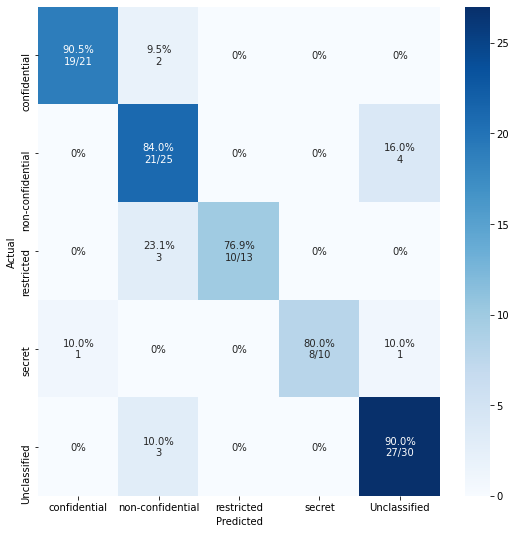

In [32]:
from sklearn import metrics
%matplotlib inline
from matplotlib import pyplot as plt
import numpy as np

labels=["confidential","non-confidential","restricted","secret","Unclassified" ]
CM = metrics.confusion_matrix(y_test, logreg_predicted,labels=["confidential","non-confidential","restricted","secret","Unclassified" ])

cm_sum = np.sum(CM, axis=1, keepdims=True)
cm_perc = CM / cm_sum.astype(float) * 100
annot = np.empty_like(CM).astype(str)
nrows, ncols = CM.shape
for i in range(nrows):
    for j in range(ncols):
        c = CM[i, j]
        p = cm_perc[i, j]
        if i == j:
            s = cm_sum[i]
            annot[i, j] = '%.1f%%\n%d/%d' % (p, c, s)
        elif c == 0:
            annot[i, j] = '0%'
        else:
            annot[i, j] = '%.1f%%\n%d' % (p, c)
cm = pd.DataFrame(CM, index=labels, columns=labels)
cm.index.name = 'Actual'
cm.columns.name = 'Predicted'
fig, ax = plt.subplots(figsize=(9,9))
abc=sns.heatmap(cm, annot=annot, fmt='', ax=ax, cmap='Blues')



<h4>Test the model using new test files</h4>

In [368]:
%run main.py \Output\project\test Output\scanTest.json

Have you been to https://www.cloudmersive.com/nlp-api to create your API key? yes/no answers onlyn
If you want to use T5 you need to get an API key, visit https://www.cloudmersive.com/nlp-api to createone, it's free! Using Spacy models and graph approach instead.
module 'tensorflow.python.framework.ops' has no attribute '_TensorLike'
You need to download a model for object detection such as TinyYOLOV3
D:\Classification\StructureMe\StructureMe-master\Output\project\test
#####################
SCAN STARTED
['D:\\Classification\\StructureMe\\StructureMe-master\\Output\\project\\test\\Test1.docx', 'D:\\Classification\\StructureMe\\StructureMe-master\\Output\\project\\test\\Test2.docx']
Got file locations
-----------------------
Fetching :  D:\Classification\StructureMe\StructureMe-master\Output\project\test\Test1.docx
-----------------------
Got content
Edit Time (minutes): 1
Page Count: 1
Word Count: 51
Character Count: 293
Line Count: 2
Paragraph Count: 1
Company: St Michael's Collegiate 

In [369]:
test_texts= read_metadata1('./Output/scanTest.json')

test_textlist = [w[1] for w in test_texts]
test_text  = [preprocess1(d) for d in test_textlist]
print('PRE-PROCESSED(TOKENIZED) DATA')

df_newtest = pd.read_json('./Output/scanTest.json',orient='index')

PRE-PROCESSED(TOKENIZED) DATA


In [373]:

for i, row in df_newtest.iterrows():   
    df_newtest.at[i,'content'] = ' '.join(test_text[i-1])
    
print(df_newtest['location'])

1    D:\Classification\StructureMe\StructureMe-mast...
2    D:\Classification\StructureMe\StructureMe-mast...
Name: location, dtype: object


In [374]:
test_counts = count_vectorizer.transform(df_newtest['content'])
test_tfidf = transformer.transform(test_counts)

predictions_new = logreg.predict(test_tfidf)
print(predictions_new)

['Unclassified' 'restricted']


<h4>Move the files to predicted folders</h4>

In [390]:
import pathlib
from pathlib import Path
import shutil

# Copy files into appropriate topic folders
for cat, filename in zip(predictions_new, df_newtest['location']):    
    src = filename
    p = Path(src)
    parentfolder = p.parents[1]
    file = p.name
    categoryfolder = Path.joinpath(parentfolder, cat)   
    if not os.path.exists(categoryfolder):
        #os.makedirs(categoryfolder)
        Path.mkdir(exist_ok=True)
       
    dest = Path.joinpath(categoryfolder, file)
    print('Moving file to : ' + str(dest))
    copystr = "copy " + src + " " + str(dest)
    shutil.copyfile(src, dest)   

print("Done")

Moving file to : D:\Classification\StructureMe\StructureMe-master\Output\project\Unclassified\Test1.docx
Moving file to : D:\Classification\StructureMe\StructureMe-master\Output\project\restricted\Test2.docx
Done
